### Кудряков Иван

#### Описание алгоритма решения

##### Используемый факт:

Сходящиеся прямые, описанные параметрами $a$ и $b$ в уравнении $y=ax+b$, в пространстве $(a, b)$ образуют прямую.

##### Алгоритм:
1) поиск границ через Canny (используется серая картинка)
2) поиск по ним прямых через Хафа
3) прореживание полученных результатов до $20$ линий (число подобрано эвристически)
4) применение ransac в пространстве $(a, b)$ для прореженных линий - получим те, которые лежат на одной прямой в этом пространстве
5) создание двух массивов точек до желаемого преобразования и после него.
    - до:
      
         пересекаю отобранные прямые прямыми y=$0$ и y=`y_max`*$0.4$. Пересечения - точки до.
    - после:
      
         сдвигаю все точки на `x_max`*`x_shift` вправо, затем точкам на верхней прямой ставлю такие же абциссы, как у соответствующих нижних. Засчет этого трапеции переходят в прямоугольники, а пересекающиеся прямые становятся вертикальными.
6) поиск оптимального проективного преобразования, которое переведет один набор точек в другой
7) применение проективного преобразования к исходной уменьшенной картинке


##### Ссылки на исходный код используемых функций:
1) [canny (препроцессинг картинки в том же файле выше)](https://github.com/scikit-image/scikit-image/blob/main/skimage/feature/_canny.py#L106)
2) [поиск прямых](https://github.com/scikit-image/scikit-image/blob/main/skimage/transform/_hough_transform.pyx#L247)
3) [прореживание линий](https://github.com/scikit-image/scikit-image/blob/main/skimage/feature/peak.py#L312)
4) [ransac](https://github.com/scikit-image/scikit-image/blob/main/skimage/measure/fit.py#L677), [модель прямой для ransac](https://github.com/scikit-image/scikit-image/blob/main/skimage/measure/fit.py#L29)
5) --
6) [поиск оптимального преобразования (ссылка на используемый метод класса)](https://github.com/scikit-image/scikit-image/blob/main/skimage/transform/_geometric.py#L643)
7) [применение проективного преобразования](https://github.com/scikit-image/scikit-image/blob/main/skimage/transform/_warps.py#L695)

#### Код с комментариями

Ячейка с импортом пакетов

In [1]:
import numpy as np
from numpy import inf
import matplotlib.pyplot as plt
from matplotlib import cm
%matplotlib inline
from os import walk    
import traceback
import sys


from skimage import io
from skimage.feature import canny
from skimage.measure import LineModelND, ransac
from skimage.transform import hough_line, hough_line_peaks, ProjectiveTransform, warp, rescale

Ячейка с загрузкой картинок (если их нет локально)

In [2]:
IN_COLAB = 'google.colab' in sys.modules
if IN_COLAB:
    !git clone https://github.com/Akuva2001/IITP_im_course_proj.git
    folder = "IITP_im_course_proj/images/"
else:
    folder = "images/"

Перечисление файлов (на всякий случай)

In [3]:
filenames = next(walk(folder), (None, None, []))[2]
filenames

['im7.jpg',
 'im6.jpg',
 'im4.jpg',
 'im5.jpg',
 'im1.jpg',
 'im2.jpg',
 'im3.jpg',
 'im12.jpg',
 'im13.jpg',
 'im11.jpg',
 'im10.jpg',
 'im8.jpg',
 'im14.jpg',
 'im9.jpg']

Вспомогательная функция для построения графика прямой. В промежутке `x_lim[0]` до `x_lim[1]` возвращает два массива точек: `x` и `y`

In [4]:
def get_line(a, b, x_lim, y_lim=None):
    x = np.linspace(*x_lim)
    y = a * x + b
    if y_lim is not None:
        y = y[y>=y_lim[0]]
        y = y[y<=y_lim[1]]
    return x, y

Функция перевода прямой из вида $(\theta, \rho)$ в $(a, b)$

$x\,\cos(\theta)+ y\,\sin(\theta)=\rho$

$y = a\cdot x + b$

In [5]:
def hough_thetaro_to_ab(theta, ro):
    a = inf if np.tan(theta) == 0 else -1 /np.tan(theta)
    b = inf if np.sin(theta)==0 else ro / np.sin(theta)
    return a, b

Ячейка с параметрами:
- `plotsize` размер первой картинки
- `min_detected_angle` максимальный угол отклонения от вертикали прямых линий, которые мы детектируем
- `x_shift` относительный размер расширения картинки по оси $x$ (при нормализации верх картинки обычно увеличивается и не помещается в старую рамку)
- `high_mul` растяжение по оси $y$ (если не растянуть, здание будет сжато из-за перспективы)
- `res_downscale` downscale результата (функция проективной нормализации выполняется медленно на больших картинках)
- `high_horizon` относительная высота, выше которой, мы надеемся, находится точка схода

In [6]:
plotsize = 5
min_detected_angle = np.pi/4
x_shift = 0.5
high_mul = 4
res_downscale = 0.25
high_horizon = 0.4

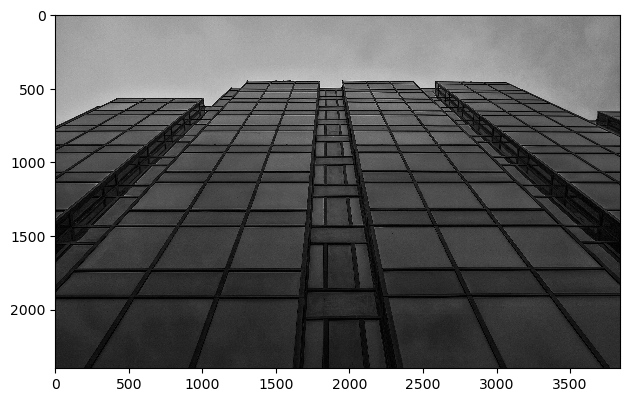

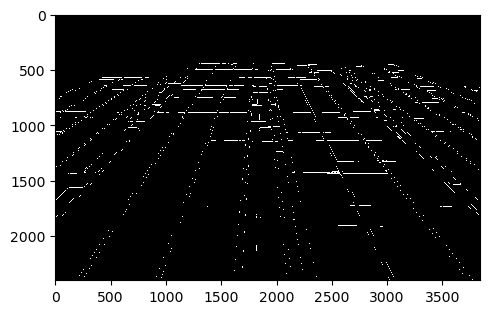

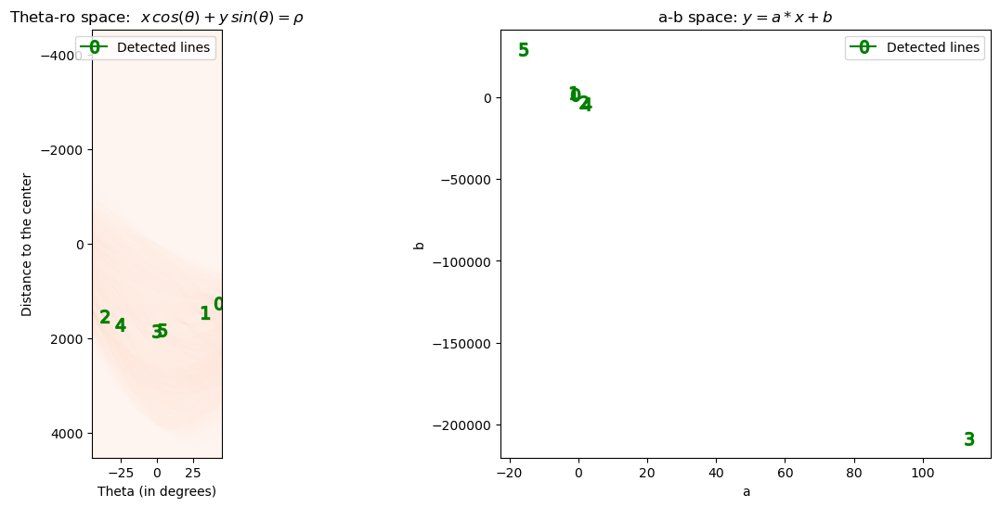

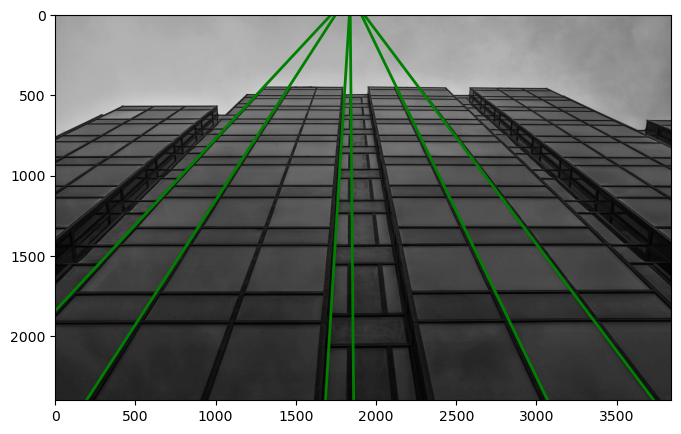

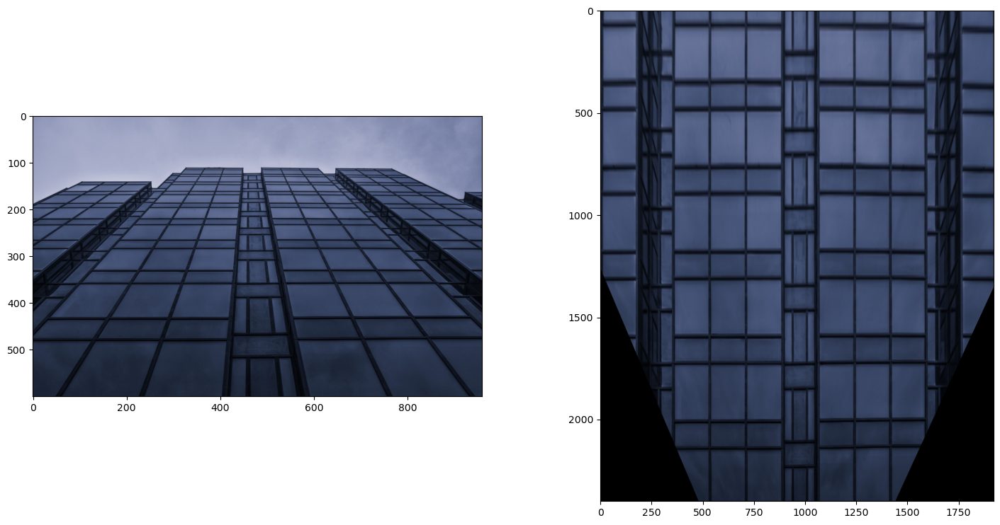

...

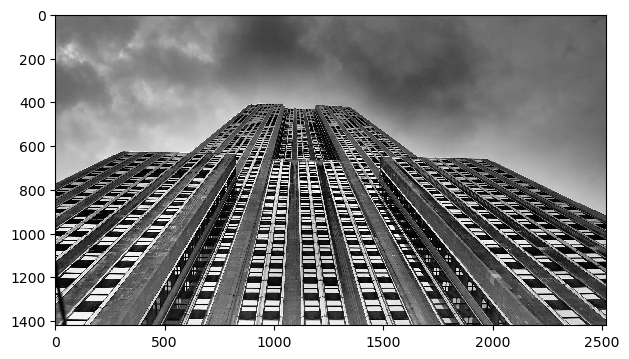

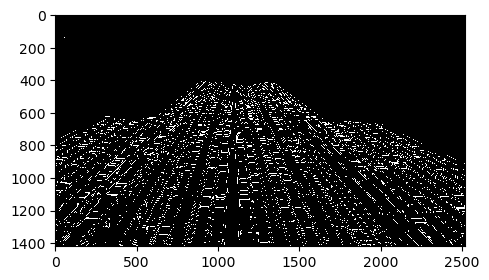

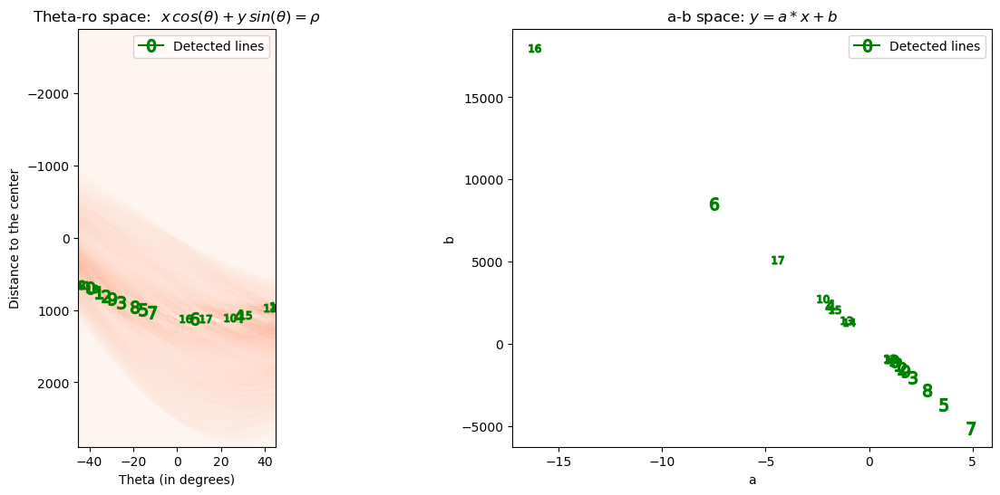

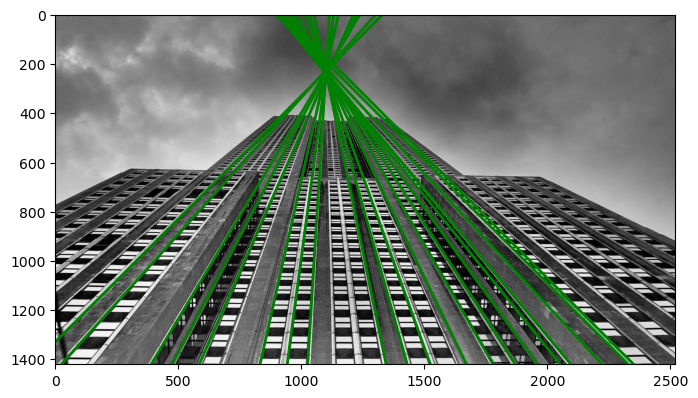

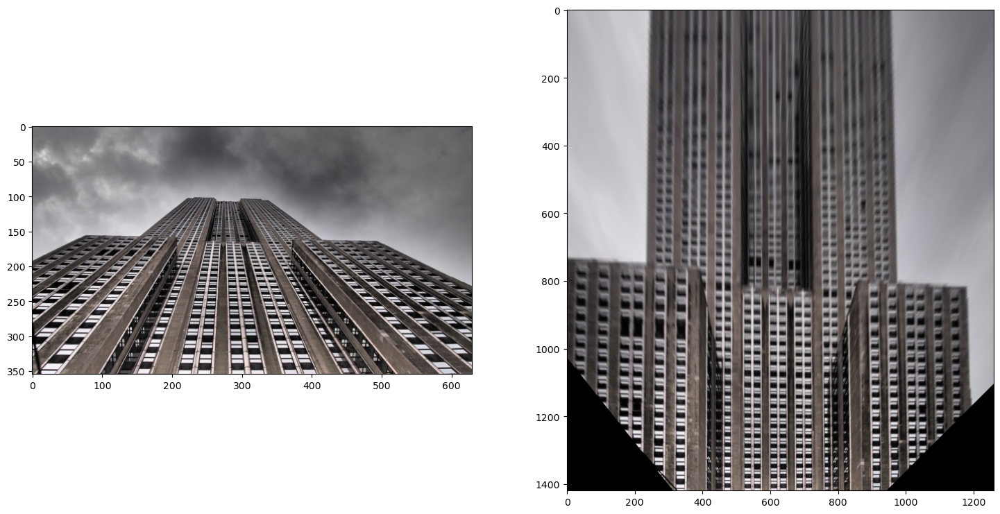

In [7]:
# Проход по всем файлам
for fname in filenames:
    
    # (0) чтение и показ исходной картинки в серых цветах
    image = io.imread(folder + fname, as_gray=True, plugin='matplotlib')
    io.imshow(image);
    
    # (1) поиск границ через Canny
    edges = canny(image, sigma=2)
    plt.figure(figsize=[plotsize, plotsize])
    io.imshow(edges);
    plt.show()
    
    # (2) Поиск прямых через Хафа
    h_all, theta_all, ro_all = hough_line(edges, theta=np.linspace(-min_detected_angle, min_detected_angle, 90))
    
    # (3) Прореживание до 20 линий
    h_selected, theta_selected, ro_selected = hough_line_peaks(h_all, theta_all, ro_all, min_distance=9, min_angle=1, 
                                                               threshold=None, num_peaks=20)
    
    # преобразование отобранных линий в вид y=ax+b
    ab_selected = np.array([hough_thetaro_to_ab(theta, ro) for theta, ro in zip(theta_selected, ro_selected)])
    
    # (4) применение ransac в пространстве (a, b) (сходящиеся в конус линии (точки их параметров) в этом пространстве образуют прямую)
    model, inliers = ransac(ab_selected, LineModelND, min_samples=min(5, len(ab_selected)-1), residual_threshold=0.05)

    # большой блок, нужный только для визуализации результатов Хафа, и отобранных линий в обоих пространствах (theta, rho) и (a, b)
    fig, ax = plt.subplots(1, 2, figsize=(15, 6))
    ax[0].imshow(h_all, cmap=cm.Reds, aspect=0.033,
                 extent=[np.rad2deg(theta_all.min()), np.rad2deg(theta_all.max()), 
                                    ro_all.max(), ro_all.min()])
    for i, (theta, ro) in enumerate(zip(theta_selected, ro_selected)):
        marker = '${}$'.format(i)
        color = 'g' if inliers[i] else 'r'
        ax[0].plot(np.rad2deg(theta), ro, color, marker=marker, ms=10)
        a, b = hough_thetaro_to_ab(theta, ro)
        ax[1].plot(a, b, color, marker=marker, ms=10)
    ax[0].set_title(r'Theta-ro space:  $x\,cos(\theta)+ y\,sin(\theta)=\rho$')
    ax[0].set_xlabel('Theta (in degrees)')
    ax[0].set_ylabel('Distance to the center')
    ax[0].legend(['Detected lines'])
    ax[1].set_title(r'a-b space: $y = a*x + b$')
    ax[1].legend(['Detected lines'])
    ax[1].set_xlabel('a')
    ax[1].set_ylabel('b')
    plt.show()
    plt.figure(figsize = (8,5))
    plt.imshow(image, cmap=cm.gray)
    
    # всего лишь сохранение разрешения исходной картинки
    y_max, x_max = edges.shape
    
    # большой блок, нужный для визуализации прямых с пункта (3) и (4) на исходной картинке, последние выделены зеленым
    for i, (theta, ro) in enumerate(zip(theta_selected, ro_selected)):
        a, b = hough_thetaro_to_ab(theta, ro)
        color = 'g' if inliers[i] else 'r'
        plt.plot(*get_line(a, b, (0, x_max)), color, lw=2)
    plt.xlim([0, x_max])
    plt.ylim([y_max, 0])
    plt.show()
    
    # всего лишь переобозначение
    lines_ab_final = ab_selected[inliers]
    
    # (5) Создание двух массивов точек до желаемого преобразования и после него.
    # до:
    #    пересекаю отобранные прямые прямыми y=0 и y=y_max*high_horizon. Пересечения - точки до.
    # после:
    #    сдвигаю все точки на x_max*x_shift вправо, затем точкам на верхней прямой ставлю 
    #    такие же абциссы, как у соответствующих нижних.
    #    Засчет этого трапеции переходят в прямоугольники, а пересекающиеся прямые становятся вертикальными.
    points_current = []
    points_desired = []
    for i, ab in enumerate(lines_ab_final):
        x_0 = (y_max*high_horizon - ab[1]) / ab[0]
        x_1 = (y_max - ab[1]) / ab[0]
        points_current.append([x_1, y_max])
        points_desired.append([x_1+int(x_max*x_shift), y_max*high_mul])
        points_current.append([x_0, y_max*high_horizon])
        points_desired.append([x_1+int(x_max*x_shift), y_max*high_horizon*high_mul])
    
    # т.к. преобразование я буду применять для уменьшенной картинки, то все координаты домножаю на коэффициент уменьшения
    # нужно только для уменьшения времени ожидания
    points_current = np.array(points_current)*res_downscale
    points_desired = np.array(points_desired)*res_downscale
    
    # (6) поиск оптимального проективного преобразования, которое переведет один набор точек в другой
    tform = ProjectiveTransform()
    tform.estimate(points_desired, points_current)
    
    # чтение оригинальной картинки уже цветной (раньше работали с чернобелой), и изменение размера
    image_rgb = io.imread(folder+fname, plugin='matplotlib')
    image_scaled = rescale(image_rgb, res_downscale, channel_axis=2)

    # (7) применение проективного преобразования
    warped = warp(image_scaled, tform, clip=False, output_shape=(int(y_max*high_mul*res_downscale), int((x_max+int(x_max*x_shift)*2)*res_downscale)))
    
    # показ оригинала и результата
    fig, ax = plt.subplots(1, 2, figsize=(18, 9))
    ax[0].imshow(image_scaled)
    ax[1].imshow(warped)
    plt.show()